# Three pair breakout strategy


## Set up

Set up the parameters used in in this strategy backtest study.

- Backtested blockchain, exchange and trading pair
- Backtesting period
- Strategy parameters for technical indicators

In [1]:
import datetime

from tradingstrategy.chain import ChainId
from tradingstrategy.timebucket import TimeBucket
from tradeexecutor.strategy.cycle import CycleDuration
from tradeexecutor.strategy.strategy_module import TradeRouting, ReserveCurrency

#
# Strategy properties
# 

# How our trades are routed.
TRADE_ROUTING = TradeRouting.uniswap_v3_usdc

# How often the strategy performs the decide_trades cycle.
TRADING_STRATEGY_CYCLE = CycleDuration.cycle_1h

# Time bucket for our candles
CANDLE_TIME_BUCKET = TimeBucket.h1

# Candle time granularity we use to trigger stop loss checks
STOP_LOSS_TIME_BUCKET = TimeBucket.m15

# Strategy keeps its cash in USDC
RESERVE_CURRENCY = ReserveCurrency.usdc

# Which trading pair we are backtesting on.
# We are using historical data feeds with fixed prices
# to test as much as backtesting history as possible
TRADING_PAIRS = [
    (ChainId.polygon, "uniswap-v3", "WETH", "USDC", 0.0005), # Ether-USD Coin (PoS) https://tradingstrategy.ai/trading-view/polygon/uniswap-v3/eth-usdc-fee-5
    (ChainId.polygon, "uniswap-v3", "WMATIC", "USDC", 0.0005), # Wrapped Matic-USD Coin (PoS) https://tradingstrategy.ai/trading-view/polygon/uniswap-v3/matic-usdc-fee-5
    (ChainId.polygon, "uniswap-v3", "XSGD", "USDC", 0.0005), # XSGD-USD Coin (PoS) https://tradingstrategy.ai/trading-view/polygon/uniswap-v3/xsgd-usdc-fee-5
]


# How much % of the cash to put on a single trade
POSITION_SIZE = 0.10

# Start with this amount of USD
INITIAL_DEPOSIT = 5_000

#
# Strategy inputs
#

# How many candles we load in the decide_trades() function for calculating indicators
LOOKBACK_CANDLE_COUNT = 90

# How many candles we use to calculate the Relative Strength Indicator
RSI_LENGTH = 14

# RSI must be above this value to open a new position.
RSI_THRESHOLD = 30

# What's the moving average length in candles for Bollinger bands
MOVING_AVERAGE_LENGTH = 20

# Bollinger band's standard deviation
STDDEV = 1.0

# Backtest range
START_AT = datetime.datetime(2023, 1, 1)

# Backtest range
END_AT = datetime.datetime(2023, 7, 3)

# Stop loss relative to the mid price during the time when the position is opened
#
# If the price drops below this level, trigger a stop loss
STOP_LOSS_PCT = 0.97

# What is the trailing stop loss level
TRAILING_STOP_LOSS_PCT = 0.988

# Activate trailing stop loss when this level is reached
TRAILING_STOP_LOSS_ACTIVATION_LEVEL=1.015

# Which pair we draw the price action charts for?
# With the current setup, 
# we only draw the price action chart for a single pair.
EXAMINED_PAIR = (ChainId.polygon, "uniswap-v3", "WETH", "USDC", 0.0005) # Ether-USD Coin (PoS) https://tradingstrategy.ai/trading-view/polygon/uniswap-v3/eth-usdc-fee-5



## Strategy logic and trade decisions

- `decide_trades` function decide what trades to take.
- See README for explanations on technical indicators used


In [2]:
from typing import List, Dict

import pandas as pd
from pandas_ta import bbands
from pandas_ta.overlap import ema
from pandas_ta.momentum import rsi

from tradingstrategy.universe import Universe

from tradeexecutor.state.visualisation import PlotKind
from tradeexecutor.state.trade import TradeExecution
from tradeexecutor.strategy.pricing_model import PricingModel
from tradeexecutor.strategy.pandas_trader.position_manager import PositionManager
from tradeexecutor.state.state import State
from tradeexecutor.strategy.trading_strategy_universe import translate_trading_pair


def decide_trades(
        timestamp: pd.Timestamp,
        universe: Universe,
        state: State,
        pricing_model: PricingModel,
        cycle_debug_data: Dict) -> List[TradeExecution]:


  # Create a position manager helper class that allows us easily to create
    # opening/closing trades for different positions
    position_manager = PositionManager(timestamp, universe, state, pricing_model)

    # The array of trades we are going to perform in this cycle.
    trades = []

    # How much cash we have in a hand
    cash = state.portfolio.get_current_cash()

    # Set up the load candle data for this decision frame,
    # We look back LOOKBACK_WINDOW candles.
    # Timestamp is the current open time, always make decision based on the last 
    # candle close, so adjust the end time minus one candle.
    start = timestamp - (LOOKBACK_CANDLE_COUNT * CANDLE_TIME_BUCKET.to_pandas_timedelta())
    end = timestamp - CANDLE_TIME_BUCKET.to_pandas_timedelta()  

    # Fetch candle data for all pairs in a single go
    candle_data = universe.candles.iterate_samples_by_pair_range(start, end)

    for pair_id, candles in candle_data:

        # Convert raw trading pair data to strategy execution format
        pair_data = universe.pairs.get_pair_by_id(pair_id)
        pair = translate_trading_pair(pair_data)

        # We have data for open, high, close, etc.
        # We only operate using candle close values in this strategy.
        close_prices = candles["close"]
        
        # Calculate RSI for candle close
        # https://tradingstrategy.ai/docs/programming/api/technical-analysis/momentum/help/pandas_ta.momentum.rsi.html#rsi
        rsi_bars = rsi(close_prices, length=RSI_LENGTH)

        if rsi_bars is None:
            # Lookback buffer does not have enough candles yet
            continue

        current_rsi = rsi_bars[-1]

        price_latest = close_prices.iloc[-1]

        # Calculate Bollinger Bands with a 20-day SMA and 2 standard deviations using pandas_ta
        # See documentation here https://tradingstrategy.ai/docs/programming/api/technical-analysis/volatility/help/pandas_ta.volatility.bbands.html#bbands
        bollinger_bands = bbands(close_prices, length=20, std=2)

        if bollinger_bands is None:
            # Lookback buffer does not have enough candles yet
            continue

        bb_upper = bollinger_bands["BBU_20_1.0"]  # Upper standard deviation
        bb_lower = bollinger_bands["BBL_20_1.0"]  # Lower standard deviation
        bb_mid = bollinger_bands["BBM_20_1.0"]  # Same as moving average 

        position_for_pair = position_manager.get_current_position_for_pair(pair)

        if not position_for_pair:
            # No open positions for the current pair, decide if BUY in this cycle.
            # We buy if the price on the chart closes above the upper Bollinger Band.
            if price_latest > bb_upper.iloc[-1] and current_rsi >= RSI_THRESHOLD:
                # We are dividing our bets equally among all three pairs
                buy_amount = cash * POSITION_SIZE
                trades += position_manager.open_1x_long(pair, buy_amount, stop_loss_pct=STOP_LOSS_PCT)

        else:
        # We have an open position, decide if SELL in this cycle.
        # We close the position when the price closes below the 20-day moving average.        
            if price_latest < bb_mid.iloc[-1]:
                trades += position_manager.close_position(position_for_pair)
        
            # Check if we have reached the level where we activate trailing stop loss
            
            if price_latest >= position_for_pair.get_opening_price() * TRAILING_STOP_LOSS_ACTIVATION_LEVEL:
                position_for_pair.trailing_stop_loss_pct = TRAILING_STOP_LOSS_PCT
                position_for_pair.stop_loss = float(price_latest * TRAILING_STOP_LOSS_PCT)
                    
        # Visualise our technical indicators.
        # With the current setup, we only visual price action for one pair,
        # instead of plotting a separate price chart for each ticker.
        visualisation = state.visualisation
        symbol = pair.base.token_symbol
        if symbol == EXAMINED_PAIR[2]:
            visualisation.plot_indicator(timestamp, f"{symbol} BB upper", PlotKind.technical_indicator_on_price, bb_upper.iloc[-1])
            visualisation.plot_indicator(timestamp, f"{symbol} BB lower", PlotKind.technical_indicator_on_price, bb_lower.iloc[-1])        
            visualisation.plot_indicator(timestamp, f"{symbol} moving avg", PlotKind.technical_indicator_on_price, bb_mid.iloc[-1])
        
        # We plot RSI for all pairs
        visualisation.plot_indicator(timestamp, f"{symbol} RSI", PlotKind.technical_indicator_detached, current_rsi)

    return trades

## Defining the trading universe

We create a trading universe with a single blockchain, single exchange and a single trading pair.
Trading Strategy framework supports complex strategies, spanning thousands of pairs and lending pools,
but we are not interested in this example.

In [3]:
import datetime
from tradingstrategy.client import Client
from tradeexecutor.strategy.trading_strategy_universe import TradingStrategyUniverse
from tradeexecutor.strategy.execution_context import ExecutionContext
from tradeexecutor.strategy.universe_model import UniverseOptions
from tradeexecutor.strategy.trading_strategy_universe import TradingStrategyUniverse
from tradeexecutor.strategy.trading_strategy_universe import load_partial_data
from tradeexecutor.strategy.execution_context import ExecutionContext
from tradeexecutor.strategy.execution_context import ExecutionMode
from tradeexecutor.strategy.universe_model import UniverseOptions


def create_trading_universe(
        ts: datetime.datetime,
        client: Client,
        execution_context: ExecutionContext,
        universe_options: UniverseOptions,
) -> TradingStrategyUniverse:

    assert not execution_context.mode.is_live_trading(), \
        f"Only strategy backtesting supported, got {execution_context.mode}"

    # Load data for our trading pair whitelist
    dataset = load_partial_data(
        client=client,
        time_bucket=CANDLE_TIME_BUCKET,
        pairs=TRADING_PAIRS,
        execution_context=execution_context,
        universe_options=universe_options,
        stop_loss_time_bucket=STOP_LOSS_TIME_BUCKET,
        start_at=START_AT,
        end_at=END_AT,
    )

    # Filter down the dataset to the pairs we specified
    universe = TradingStrategyUniverse.create_multichain_universe_by_pair_descriptions(
        dataset,
        TRADING_PAIRS,
        reserve_token_symbol="USDC"  # Pick any USDC - does not matter as we do not route
    )

    return universe

## Set up the market data client

The [Trading Strategy market data client](https://tradingstrategy.ai/docs/programming/api/client/index.html)
is the Python library responsible for managing the data feeds needed to run the backtest.

We set up the market data client with an API key.

[If you do not have an API key yet, you can register one](https://tradingstrategy.ai/trading-view/backtesting).

In [4]:
from tradingstrategy.client import Client

client = Client.create_jupyter_client()

Started Trading Strategy in Jupyter notebook environment, configuration is stored in /root/.tradingstrategy


## Load data

This will pull JSONL data feed for the trading pair from Trading Strategy oracle node.

In [5]:
from tradeexecutor.strategy.execution_context import ExecutionMode
from tradeexecutor.strategy.universe_model import UniverseOptions

universe = create_trading_universe(
    END_AT,
    client,
    ExecutionContext(mode=ExecutionMode.data_preload),
    UniverseOptions()
)
print(f"We loaded {universe.universe.candles.get_candle_count():,} candles, {universe.universe.pairs.get_count()} trading pairs")

We loaded 22,668 candles, 3 trading pairs


## Run backtest

Run backtest using giving trading universe and strategy function.

- Running the backtest outputs `state` object that contains all the information
on the backtesting position and trades.


In [6]:
from tradeexecutor.backtest.backtest_runner import run_backtest_inline

state, universe, debug_dump = run_backtest_inline(
    name="Bollinger bands example",
    start_at=START_AT,
    end_at=END_AT,
    client=client,
    cycle_duration=TRADING_STRATEGY_CYCLE,
    decide_trades=decide_trades,
    universe=universe,
    initial_deposit=INITIAL_DEPOSIT,
    reserve_currency=RESERVE_CURRENCY,
    trade_routing=TRADE_ROUTING,
)

trade_count = len(list(state.portfolio.get_all_trades()))
print(f"Backtesting completed, backtested strategy made {trade_count} trades")

  0%|          | 0/31708800 [00:00<?, ?it/s]

Backtesting completed, backtested strategy made 695 trades


## Analysing the backtest results

Examine `state` that contains all actions the trade executor took.


In [7]:
print(f"Positions taken: {len(list(state.portfolio.get_all_positions()))}")
print(f"Trades made: {len(list(state.portfolio.get_all_trades()))}")

Positions taken: 349
Trades made: 695


### Price action and technical indicators

- Plot the price action for the trading pair we backtested.
- Overlay trades on the top of technical indicators

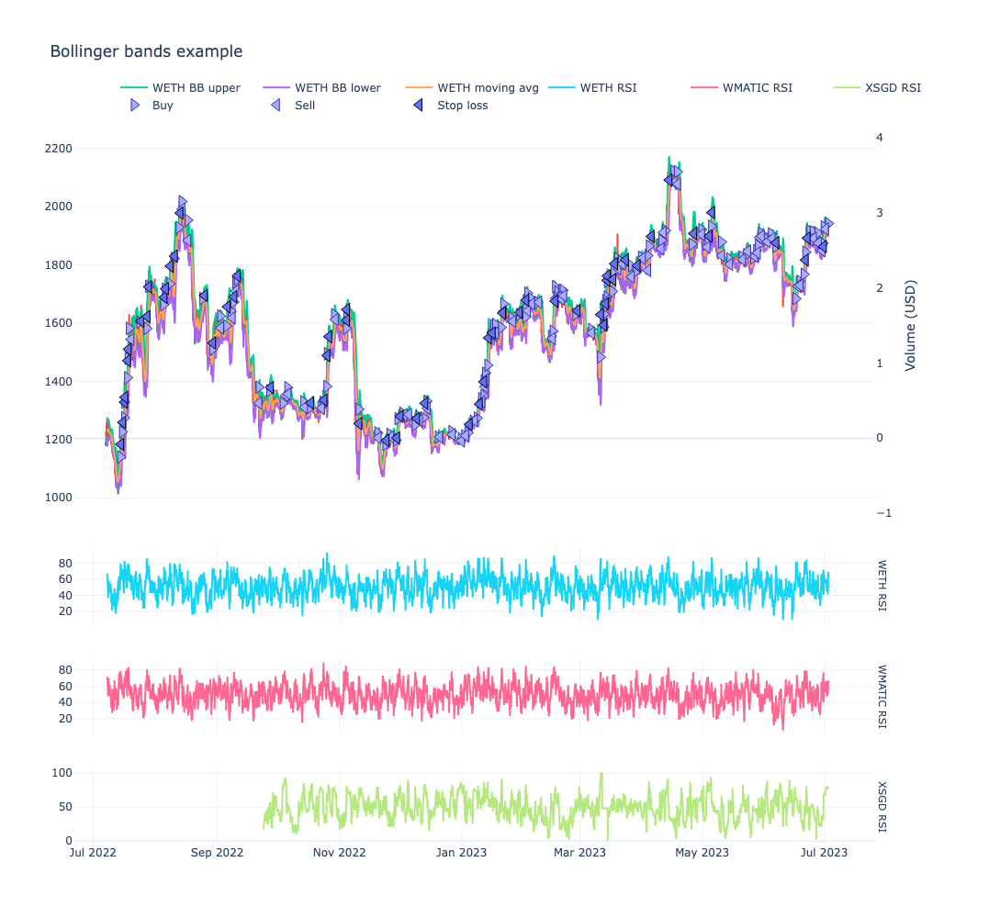

In [8]:
# This is added to improve the image resolution of matplotlib charts generated by quantstats library
%config InlineBackend.figure_format = 'svg'

from tradeexecutor.visual.single_pair import visualise_single_pair, visualise_single_pair_positions_with_duration_and_slippage
from tradingstrategy.charting.candle_chart import VolumeBarMode

examined_pair = universe.get_pair_by_human_description(EXAMINED_PAIR)

figure = visualise_single_pair(
    state,
    universe.universe.candles,
    pair_id=examined_pair.internal_id,
    start_at=START_AT,
    end_at=END_AT,
    volume_axis_name="Volume (USD)",
    height = 1000,
)

figure.show()

### Equity curve and drawdown

Visualise equity curve and related performnace over time.

- Returns

- Drawdown

- Daily returns



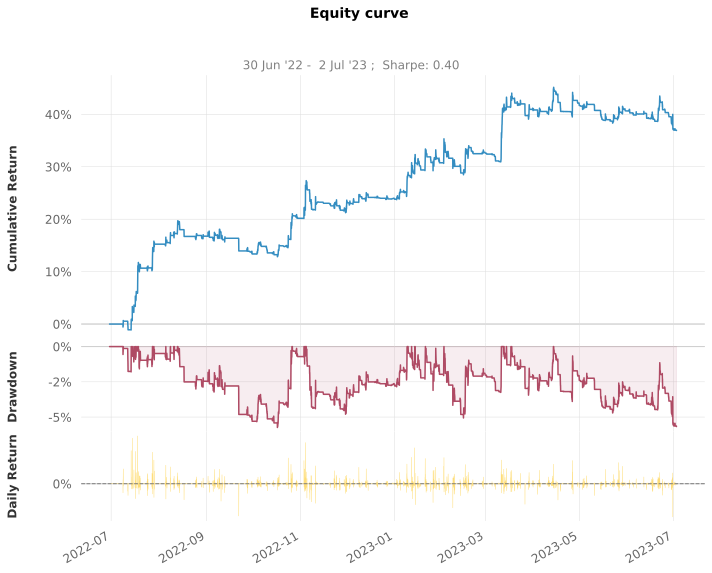

In [9]:
# Needed to improve the resolution of matplotlib chart used here
%config InlineBackend.figure_format = 'svg'

from tradeexecutor.visual.equity_curve import calculate_equity_curve, calculate_returns
from tradeexecutor.visual.equity_curve import visualise_equity_curve

curve = calculate_equity_curve(state)
returns = calculate_returns(curve)
visualise_equity_curve(returns)

### Returns monthly breakdown

- Monthly returns
- Best day/week/month/year


/usr/local/lib/python3.10/site-packages/quantstats/stats.py:968: FutureWarning:

In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.



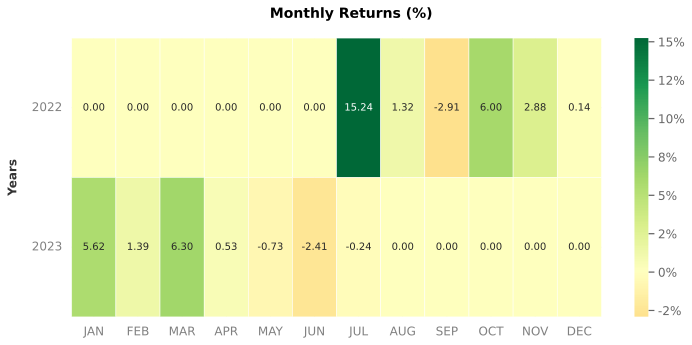

In [10]:
from tradeexecutor.visual.equity_curve import visualise_returns_over_time

visualise_returns_over_time(returns)

### Returns distribution

Show the difference between good and bad trading periods.

- Daily/montly/yearly

- Best/worst/avg.

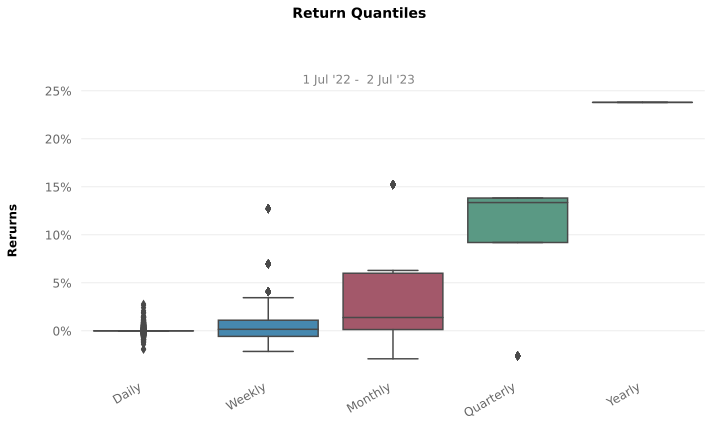

In [11]:
from tradeexecutor.visual.equity_curve import visualise_returns_distribution

visualise_returns_distribution(returns)

### Benchmarks

Here we benchmark the strategy performance against some baseline scenarios.

- Buy and hold US dollar
- Buy and hold ETH


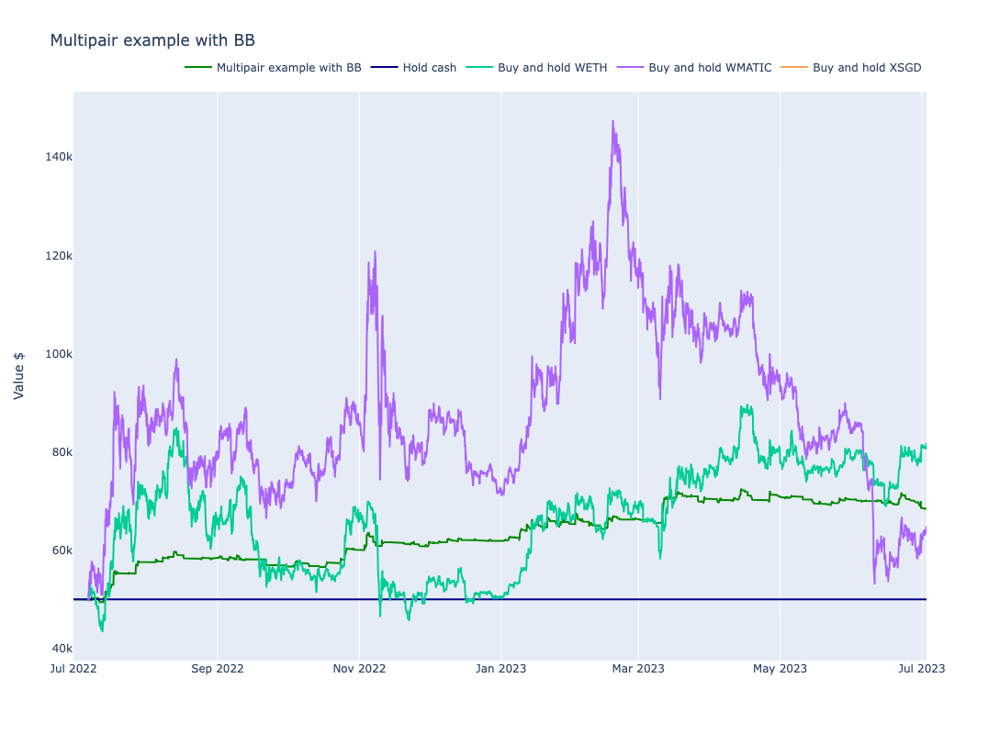

In [12]:
from tradeexecutor.visual.benchmark import visualise_benchmark

examined_candles = universe.universe.candles.get_candles_by_pair(examined_pair.internal_id)
# Benchmark strategy against buy and hold any of our traded assets
benchmarks = pd.DataFrame()
benchmarks.index = examined_candles.index
for pair_description in TRADING_PAIRS:
    token_symbol = pair_description[2]
    pair = universe.get_pair_by_human_description(pair_description)
    benchmarks[token_symbol] = universe.universe.candles.get_candles_by_pair(pair.internal_id)["close"]

fig = visualise_benchmark(
    "Multipair example with BB",
    portfolio_statistics=state.stats.portfolio,
    all_cash=state.portfolio.get_initial_deposit(),
    benchmark_indexes=benchmarks,
    start_at=START_AT,
    end_at=END_AT,
    height=800
)

fig.show()

### Analyse trade statistics

Here we calculate statistics on how well the strategy performed.

- Won/lost trades
- Timeline of taken positions with color coding of trade performance


In [13]:
from tradeexecutor.analysis.trade_analyser import build_trade_analysis

analysis = build_trade_analysis(state.portfolio)

### Trade summary

Overview of strategy performance



In [14]:
from IPython.core.display_functions import display

summary = analysis.calculate_summary_statistics()

with pd.option_context("display.max_row", None):
    display(summary.to_dataframe())

,0
Trading period length,359 days
Return %,36.92%
Annualised return %,37.51%
Cash at start,"$50,000.00"
Value at end,"$68,459.75"
Trade volume,"$11,558,762.82"
Position win percent,50.58%
Total positions,346
Won positions,175
Lost positions,171


In [15]:
from tradeexecutor.analysis.multipair import analyse_multipair
from tradeexecutor.analysis.multipair import format_multipair_summary

multipair_summary = analyse_multipair(state)
display(format_multipair_summary(multipair_summary))

,Trading pair,Positions,Trades,Total PnL USD,Best,Worst,Avg,Median,Volume,Wins,Losses,Take profits,Stop losses,Trailing stop losses
2,WMATIC-USDC,139,277,"8,096.60",11.56%,-6.54%,0.41%,0.39%,"4,253,912.52",78,78,0,86,71
1,WETH-USDC,131,261,"7,301.90",9.73%,-4.04%,0.38%,-0.01%,"4,571,217.40",65,65,0,60,53
0,XSGD-USDC,79,157,"3,061.24",2.73%,-1.00%,0.22%,-0.10%,"2,733,632.90",33,33,0,11,0


In [16]:
from tradeexecutor.visual.equity_curve import calculate_equity_curve, calculate_returns
from tradeexecutor.analysis.advanced_metrics import visualise_advanced_metrics, AdvancedMetricsMode

equity = calculate_equity_curve(state)
returns = calculate_returns(equity)
metrics = visualise_advanced_metrics(returns, mode=AdvancedMetricsMode.full)

with pd.option_context("display.max_row", None):
    display(metrics)

,Strategy
Start Period,2022-07-01
End Period,2023-07-02
Risk-Free Rate,0.0%
Time in Market,31.0%
Cumulative Return,36.92%
CAGR﹪,36.8%
Sharpe,0.49
Prob. Sharpe Ratio,99.38%
Smart Sharpe,0.47
Sortino,0.85


### Position and trade timeline

Display all positions and how much profit they made.

In [17]:
from tradeexecutor.analysis.trade_analyser import expand_timeline

timeline = analysis.create_timeline()

expanded_timeline, apply_styles = expand_timeline(
        universe.universe.exchanges,
        universe.universe.pairs,
        timeline)

# Do not truncate the row output
with pd.option_context("display.max_row", None):
    display(apply_styles(expanded_timeline))


Remarks,Opened at,Duration,Exchange,Base asset,Quote asset,Position max value,PnL USD,PnL %,Open mid price USD,Close mid price USD,Trade count,LP fees
SL,2022-07-08,5 hours 45 mins,Uniswap v3,WMATIC,USDC,"$15,000.00",$270.90,1.81%,$0.594597,$0.605336,2,$15.14
SL,2022-07-11,4 hours 45 mins,Uniswap v3,WMATIC,USDC,"$15,081.27",$-819.87,-5.44%,$0.595430,$0.563060,2,$14.67
SL,2022-07-13,2 hours 15 mins,Uniswap v3,WMATIC,USDC,"$14,835.31",$834.05,5.62%,$0.600092,$0.633830,2,$15.26
SL,2022-07-14,2 hours 30 mins,Uniswap v3,WMATIC,USDC,"$15,085.52",$72.58,0.48%,$0.637198,$0.640264,2,$15.13
SL,2022-07-14,5 hours 30 mins,Uniswap v3,WETH,USDC,"$15,107.30",$556.87,3.69%,"$1,140.874751","$1,182.928843",2,$15.39
SL,2022-07-14,3 hours 30 mins,Uniswap v3,WMATIC,USDC,"$15,107.30",$399.47,2.64%,$0.672753,$0.690542,2,$15.31
SL,2022-07-15,7 hours 45 mins,Uniswap v3,WETH,USDC,"$15,394.20",$386.53,2.51%,"$1,227.023912","$1,257.832955",2,$15.59
SL,2022-07-16,2 hours,Uniswap v3,WETH,USDC,"$15,510.16",$634.56,4.09%,"$1,275.310558","$1,327.486983",2,$15.83
SL,2022-07-16,14 hours 30 mins,Uniswap v3,WMATIC,USDC,"$10,857.11",$484.95,4.47%,$0.737579,$0.770524,2,$11.10
SL,2022-07-16,4 hours,Uniswap v3,WETH,USDC,"$12,443.40",$145.18,1.17%,"$1,328.815135","$1,344.318292",2,$12.52


## Finishing notes

Print out a line to signal the notebook finished the execution successfully.

In [18]:
print("All ok")

All ok
